# Multiligual models





## The task: Multilingual document embeddings

We work with a dataset of almost 5,000 news editorials in English and French. Each editorial is translated (by human experts) from English into French. We thus have a dataset of gold translations. We will encode the English and French versions in a single embedding space.

We want each translated pair to be located close together in the document embedding space, despite the fact that they are in different languages. Multilingual document embedding models are good at this. Monolingual models generally are not, though some models not advertised as multilingual nevertheless contain enough translation pairs in their training data that they perform better than one might expect on this task.

You can find an overview and performance comparison of some document embedding models on the [Sentence-Transformers](https://www.sbert.net/docs/pretrained_models.html) site.

## Setup

In [1]:
## If working in Colab, uncomment

# # Install packages that we need
# %%capture
# !pip install sentencepiece
# !pip install transformers
# !pip install sentence-transformers
# !pip install umap-learn
# !pip install altair --upgrade -U
# !pip install pyarrow==11.0.0
# !pip install vegafusion
# !pip install vegafusion-python-embed
# !pip install vl-convert-python

In [2]:
# Import packages

# For working with LMs
from   sentence_transformers import SentenceTransformer
import torch
import numpy as np
import pandas as pd

# For printing long documents
import textwrap

# For status bars
from tqdm.notebook import tqdm

# For dimensionality reduction
import umap.umap_ as umap

# For plotting
import matplotlib.pyplot as plt
import altair as alt

In [3]:
# set device to use
device = 'cpu'
if torch.cuda.is_available():
    device = 'cuda'
elif torch.backends.mps.is_available():
    device = 'mps'
print(f'Using device: {device}')

Using device: mps


## Load data

In [4]:
# Download the editorial data file
url = "https://github.com/wilkens-teaching/info3350-f24/raw/main/data/news/news-translations-all.csv.gz"
input_texts = pd.read_csv(url).head(1000) # Subset to limit compute
#input_texts = pd.read_csv(url) # No subsetting, more compute
display(input_texts.sample(5))
print("Number of documents:", len(input_texts))
print(f'Mean document length: {int(input_texts.English.apply(lambda x: len(x.split())).mean())} words')

,English,French
499,The Trouble with Treating Trauma\n<AUTHOR name...,Difficultés liées au traitement des traumatism...
687,"Cry, Beloved Burma\n<AUTHOR name=""U Gambira"">\...","Pleures, Birmanie chérie !\n<AUTHOR name=""U Ga..."
85,America’s Socialism for the Rich\n<AUTHOR name...,Etats-Unis : le socialisme pour les riches\n<A...
596,"The Power Gap\n<AUTHOR name=""Ian Davidson"">\n<...","Le Gouffre des puissances\n<AUTHOR name=""Ian D..."
974,The Soft Underbelly of Europe\u0027s \\n<AUTHO...,Le point faible du « noyau dur » de l\u0027Eur...


Number of documents: 1000
Mean document length: 858 words


**Note the average document length.** It exceeds the input window of most of the models we might have used from the Sentence-Transformers project. Our documents will be truncated silently when we encode them. This is fine for our purposes, since the first *x* tokens of each member of a translation pair will cover roughly the same meaning. But truncation could be a significant issue for other kinds of document similarity tasks. 

If you need to process longer documents, you'll have to chunk them or to find a model that can handle longer input sequences.

## English-only embeddings

We are using a [model similar to ST5, but much smaller](https://huggingface.co/sentence-transformers/paraphrase-albert-small-v2) (about 12M parameters vs. 100M+, depending on the model). ST5 actually does OK on multilingual embeddings, despite not being an explicitly multilingual model (it's just very big and appears to contain a decent number of multilingual pairs in its training data).

You can find an [overview of sentence embedding models](https://www.sbert.net/docs/sentence_transformer/pretrained_models.html#) on the SBERT site.

In [5]:
# Load/initialize monolingual model
model_english = SentenceTransformer('paraphrase-albert-small-v2', device=device)

/Users/mwilkens/miniforge3/envs/3350/lib/python3.11/site-packages/huggingface_hub/file_download.py:1150: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [6]:
%%time
# Create the document embeddings by running the texts through the English model
mono_en = model_english.encode(input_texts.English)
mono_fr = model_english.encode(input_texts.French)

CPU times: user 15.9 s, sys: 1.15 s, total: 17.1 s
Wall time: 22.7 s


In [7]:
# embeddings shape
mono_en.shape

(1000, 768)

Mean similarity (monolingual model): 0.47759128


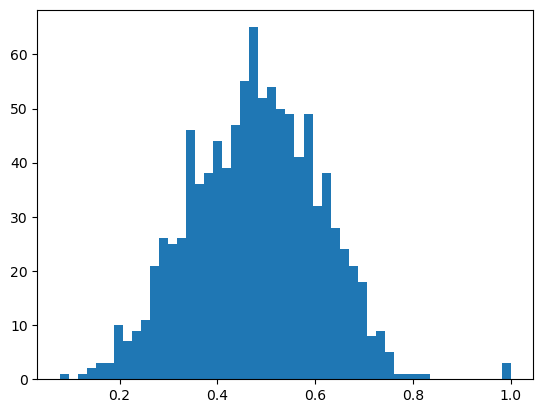

In [8]:
# normalize embeddings to unit magnitude
mono_en = mono_en / np.linalg.norm(mono_en, axis=1, keepdims=True) 
mono_fr = mono_fr / np.linalg.norm(mono_fr, axis=1, keepdims=True) 

# calculate and plot pairwise cosine similarities
mono_similarities = [np.dot(mono_en[i], mono_fr[i]) for  i in range(len(mono_en))]
print("Mean similarity (monolingual model):", np.mean(mono_similarities)) 
plt.hist(mono_similarities, bins=50);

In [9]:
%%time
# Reduce the embeddings to two dimensions for visualization
reducer_mono = umap.UMAP().fit(np.concatenate([mono_en, mono_fr]))
umap_mono_en = reducer_mono.transform(mono_en)
umap_mono_fr = reducer_mono.transform(mono_fr)

CPU times: user 14 s, sys: 1.26 s, total: 15.2 s
Wall time: 9.51 s


In [10]:
# Format the embeddings, texts, labels, and document ids in a pandas dataframe for plotting purposes
df_en = pd.DataFrame(
    {
      "doc_id": list(range(len(input_texts))),
      "Language": "English",
      "Text": input_texts.English,
      "x_mono": umap_mono_en[:, 0],
      "y_mono": umap_mono_en[:, 1],
    }
)
df_fr = pd.DataFrame(
    {
      "doc_id": list(range(len(input_texts))),
      "Language": "French",
      "Text": input_texts.French,
      "x_mono": umap_mono_fr[:, 0],
      "y_mono": umap_mono_fr[:, 1],
    }
)
df = pd.concat([df_en, df_fr], ignore_index=True)

In [11]:
df.loc[df.doc_id==0]

,doc_id,Language,Text,x_mono,y_mono
0,0,English,"To Cure the Economy\n<AUTHOR name=""Joseph E. S...",3.996419,8.454529
1000,0,French,"Soigner l’économie\n<AUTHOR name=""Joseph E. St...",9.526433,9.873618


In [12]:
# Plot the documents, color the points by language, create hover tooltips with document info
#alt.data_transformers.enable("vegafusion") # can be useful for large datasets
base = alt.Chart(df, title="English embeddings").mark_circle(size=200, opacity=0.1).encode(
    alt.X('x_mono',
    ),
    alt.Y("y_mono",
    ),
    # Color by ...
    color = "Language",
    tooltip=['Text', 'doc_id'],
    )
base.interactive().properties(
    width=500,
    height=500
)

/Users/mwilkens/miniforge3/envs/3350/lib/python3.11/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/Users/mwilkens/miniforge3/envs/3350/lib/python3.11/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.Chart(...)

## Multilingual

In [13]:
# load multilingual model
model_multi   = SentenceTransformer('paraphrase-multilingual-MiniLM-L12-v2', device=device)

/Users/mwilkens/miniforge3/envs/3350/lib/python3.11/site-packages/huggingface_hub/file_download.py:1150: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [14]:
%%time
# Create the document embeddings by running the texts through the multilingual model
multi_en = model_multi.encode(input_texts.English)
multi_fr = model_multi.encode(input_texts.French)

CPU times: user 16.6 s, sys: 1.18 s, total: 17.7 s
Wall time: 17.1 s


In [15]:
#embeddings shape
multi_en.shape

(1000, 384)

In [16]:
# normalize embeddings to unit magnitude
multi_en = multi_en / np.linalg.norm(multi_en, axis=1, keepdims=True) 
multi_fr = multi_fr / np.linalg.norm(multi_fr, axis=1, keepdims=True) 

Mean similarity (multilingual model): 0.88891053


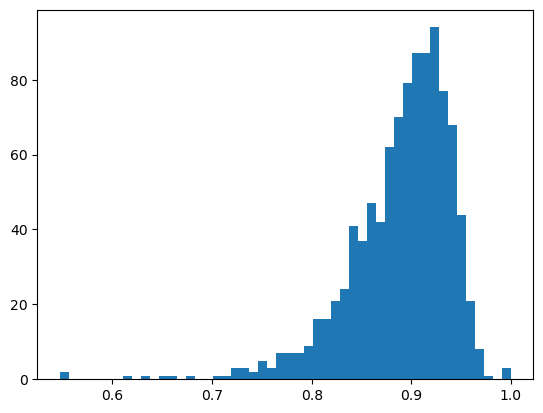

In [17]:
# calculate and plot pairwise cosine similarities
multi_similarities = [np.dot(multi_en[i], multi_fr[i]) for  i in range(len(multi_en))]
print("Mean similarity (multilingual model):", np.mean(multi_similarities)) 
plt.hist(multi_similarities, bins=50);

In [18]:
%%time
# Reduce the embeddings to two dimensions for visualization
reducer_multi = umap.UMAP().fit(np.concatenate([multi_en, multi_fr]))
umap_multi_en = reducer_multi.transform(multi_en)
umap_multi_fr = reducer_multi.transform(multi_fr)

CPU times: user 10.2 s, sys: 1.03 s, total: 11.3 s
Wall time: 6.03 s


In [19]:
# Add multilingual results to dataframe
df.loc[df.Language=='English','x_multi'] = umap_multi_en[:,0]
df.loc[df.Language=='English','y_multi'] = umap_multi_en[:,1]
df.loc[df.Language=='French','x_multi']  = umap_multi_fr[:,0]
df.loc[df.Language=='French','y_multi']  = umap_multi_fr[:,1]
df['mono_similarity']  = np.concatenate([mono_similarities,mono_similarities])
df['multi_similarity'] = np.concatenate([multi_similarities,multi_similarities])

In [20]:
df.loc[df.doc_id==0]

,doc_id,Language,Text,x_mono,y_mono,x_multi,y_multi,mono_similarity,multi_similarity
0,0,English,"To Cure the Economy\n<AUTHOR name=""Joseph E. S...",3.996419,8.454529,12.233630,7.888289,0.44893,0.893222
1000,0,French,"Soigner l’économie\n<AUTHOR name=""Joseph E. St...",9.526433,9.873618,12.068446,7.848253,0.44893,0.893222


In [21]:
# Plot the documents, color the points by their category, create hover tooltips with document info

base = alt.Chart(df, title="Multilingual embeddings").mark_circle(size=200, opacity=0.1).encode(
    alt.X('x_multi',
    ),
    alt.Y("y_multi",
    ),
    # Color by ...
    color = "Language",
    tooltip=['Text', 'doc_id'],
    )
base.interactive().properties(
    width=500,
    height=500
)

/Users/mwilkens/miniforge3/envs/3350/lib/python3.11/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/Users/mwilkens/miniforge3/envs/3350/lib/python3.11/site-packages/altair/utils/core.py:395: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.Chart(...)